In [12]:
import pandas as pd
from sklearn.utils import shuffle
from sklearn import tree
from sklearn.model_selection import train_test_split
import numpy as np
from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO  
from IPython.display import Image  
import pydotplus

In [2]:
df = pd.read_csv("/Users/nasim/Documents/Workspace/Frauenloop_intro_to_ml/week3_Regression/clean_charity_ml.csv", index_col = 0)

In [3]:
df.income.value_counts()

0    34014
1    11208
Name: income, dtype: int64

In [4]:
min_class=min(df.income.value_counts())
df_ml0= df[df['income']==0].sample(n= min_class)
df_ml1= df[df['income']==1]

df_balanced_undersampled= shuffle(pd.concat([df_ml0, df_ml1 ]))


In [5]:
df.head()

,age,education-num,capital-gain,capital-loss,hours-per-week,workclass_ Federal-gov,workclass_ Local-gov,workclass_ Private,workclass_ Self-emp-inc,workclass_ Self-emp-not-inc,...,native-country_ Puerto-Rico,native-country_ Scotland,native-country_ South,native-country_ Taiwan,native-country_ Thailand,native-country_ Trinadad&Tobago,native-country_ United-States,native-country_ Vietnam,native-country_ Yugoslavia,income
0,0.301370,0.800000,0.667492,0.0,0.397959,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
1,0.452055,0.800000,0.000000,0.0,0.122449,0,0,0,0,1,...,0,0,0,0,0,0,1,0,0,0
2,0.287671,0.533333,0.000000,0.0,0.397959,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
3,0.493151,0.400000,0.000000,0.0,0.397959,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
4,0.150685,0.800000,0.000000,0.0,0.397959,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [6]:
X = df_balanced_undersampled.iloc[:,:-1]
y = df_balanced_undersampled.loc[:,['income']]

In [7]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state =42)

In [8]:
clf = tree.DecisionTreeClassifier()
clf = clf.fit(X_train, y_train)

In [12]:

feature_cols = ['age' , 'capital_gain']
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('diabetes.png')
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.264846 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.264846 to fit



In [13]:
X_train, X_test, y_train, y_test = train_test_split(X.iloc[:,:5], y, test_size = 0.20, random_state =42)


In [14]:
clf1 = tree.DecisionTreeClassifier()
clf1 = clf1.fit(X_train, y_train)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.303699 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.303699 to fit



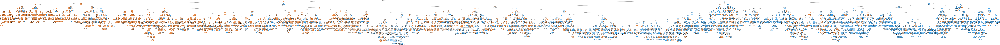

In [15]:
dot_data = StringIO()
export_graphviz(clf1, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('tree1.png')
Image(graph.create_png())

In [27]:
X = df_balanced_undersampled.iloc[:,:-1]
y = df_balanced_undersampled.loc[:,['income']]

In [28]:
X.shape[0]

22416

In [29]:
clf = tree.DecisionTreeClassifier(min_samples_leaf = 20)


In [37]:
from sklearn.model_selection import learning_curve


train_sizes_vals = [0.01*X.shape[0] , 0.10* X.shape[0], 0.2*X.shape[0], 0.5*X.shape[0]]
train_sizes_vals = [int(x) for x in train_sizes_vals]
clf = tree.DecisionTreeClassifier()

train_sizes, train_scores, valid_scores = learning_curve(clf, X.iloc[:,:5], y, train_sizes=train_sizes_vals, cv=5)


In [38]:
train_sizes

array([  224,  2241,  4483, 11208])

In [39]:
train_scores

array([[0.96875   , 0.98214286, 0.98214286, 0.98214286, 0.98214286],
       [0.90049085, 0.90539938, 0.90539938, 0.90539938, 0.90539938],
       [0.87218381, 0.89136739, 0.89092126, 0.89092126, 0.89092126],
       [0.85465739, 0.85992148, 0.85626338, 0.8526945 , 0.8526945 ]])

In [40]:
cv_score= np.sum(train_scores, axis=1)/5
cv_valid_score = np.sum(valid_scores, axis=1)/5

In [41]:
valid_scores

array([[0.68309545, 0.67016057, 0.6837645 , 0.67715306, 0.68964748],
       [0.69580731, 0.69313113, 0.691124  , 0.69544846, 0.69946452],
       [0.71141838, 0.71052632, 0.69536128, 0.71151272, 0.71262829],
       [0.72457627, 0.72190009, 0.72301517, 0.73003124, 0.7264614 ]])

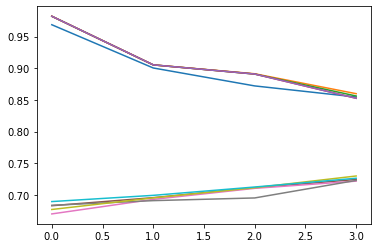

In [42]:
import matplotlib.pyplot as plt
plt.plot(train_scores)
plt.plot(valid_scores)


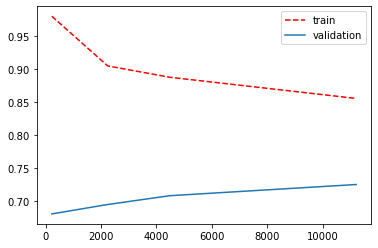

In [44]:
plt.plot(train_sizes ,  cv_score  , 'r--')
plt.plot(train_sizes ,  cv_valid_score  )
plt.legend(['train','validation'])


In [45]:
from sklearn.linear_model import LogisticRegression
clf = LogisticRegression(random_state=100 , solver = 'lbfgs' , dual=False , max_iter=1000 )

train_sizes, train_scores, valid_scores = learning_curve(clf, X, np.ravel(y), train_sizes=train_sizes_vals, cv=5)


In [46]:
cv_score= np.sum(train_scores, axis=1)/5
cv_valid_score = np.sum(valid_scores, axis=1)/5

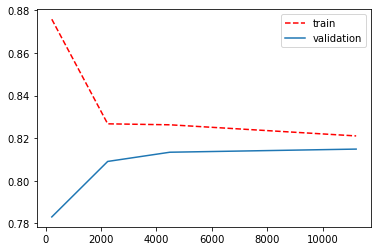

In [47]:

plt.plot(train_sizes ,  cv_score  , 'r--')
plt.plot(train_sizes ,  cv_valid_score  )
plt.legend(['train','validation'])
plt.show()

In [99]:
from sklearn.metrics import accuracy_score , recall_score , precision_score , fbeta_score

def plot_learning_curves(model, X, y):
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2)
    train_errors, val_errors = [], []
    for m in range(1, len(X_train)):
        model.fit(X_train[:m], y_train[:m])
        y_train_predict = model.predict(X_train[:m])
 
        y_val_predict = model.predict(X_val)
        train_errors.append(accuracy_score(y_train[:m], y_train_predict))
        val_errors.append(accuracy_score(y_val, y_val_predict))
    plt.plot(np.sqrt(train_errors), "r-+", linewidth=2, label="train")
    plt.plot(np.sqrt(val_errors), "b-", linewidth=3, label="val")

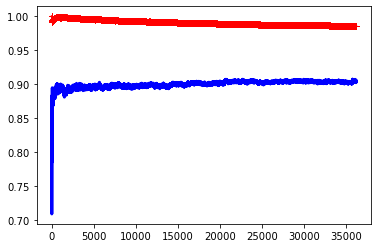

In [100]:
# don't run this cell will take a long time 
#plot_learning_curves(tree.DecisionTreeClassifier(), X, y)